In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from datetime import datetime as dt
import itertools

%matplotlib inline

In [3]:
folder='C:/Users/admin/Desktop/PP/Datasets/final/'

raw_data_1 = pd.read_csv(folder +'2009-10.csv')
raw_data_2 = pd.read_csv(folder +'2010-11.csv')
raw_data_3 = pd.read_csv(folder +'2011-12.csv')
raw_data_4 = pd.read_csv(folder +'2012-13.csv')
raw_data_5 = pd.read_csv(folder +'2013-14.csv')
raw_data_6 = pd.read_csv(folder +'2014-15.csv')
raw_data_7 = pd.read_csv(folder +'2015-16.csv')
raw_data_8 = pd.read_csv(folder +'2016-17.csv')
raw_data_9 = pd.read_csv(folder +'2017-18.csv')
raw_data_10 = pd.read_csv(folder +'2018-19.csv')

In [4]:
columns_req = ['Date','HomeTeam','AwayTeam','FTHG','FTAG','FTR']

playing_statistics_1 = raw_data_1[columns_req]                      
playing_statistics_2 = raw_data_2[columns_req]
playing_statistics_3 = raw_data_3[columns_req]
playing_statistics_4 = raw_data_4[columns_req]
playing_statistics_5 = raw_data_5[columns_req]
playing_statistics_6 = raw_data_6[columns_req]
playing_statistics_7 = raw_data_7[columns_req]
playing_statistics_8 = raw_data_8[columns_req]
playing_statistics_9 = raw_data_9[columns_req]
playing_statistics_10 = raw_data_10[columns_req]

In [5]:
playing_statistics_1.groupby('HomeTeam').mean().T.columns

Index(['Arsenal', 'Aston Villa', 'Birmingham', 'Blackburn', 'Bolton',
       'Burnley', 'Chelsea', 'Everton', 'Fulham', 'Hull', 'Liverpool',
       'Man City', 'Man United', 'Portsmouth', 'Stoke', 'Sunderland',
       'Tottenham', 'West Ham', 'Wigan', 'Wolves'],
      dtype='object', name='HomeTeam')

In [6]:
# Gets the goals scored agg arranged by teams and matchweek
def get_goals_scored(playing_stat):
    # Create a dictionary with team names as keys
    teams = {}
    for i in playing_stat.groupby('HomeTeam').mean().T.columns:
        teams[i] = []
    
    # the value corresponding to keys is a list containing the match location.
    for i in range(len(playing_stat)):
        HTGS = playing_stat.iloc[i]['FTHG']
        ATGS = playing_stat.iloc[i]['FTAG']
        teams[playing_stat.iloc[i].HomeTeam].append(HTGS)
        teams[playing_stat.iloc[i].AwayTeam].append(ATGS)
    
    # Create a dataframe for goals scored where rows are teams and cols are matchweek.
    GoalsScored = pd.DataFrame(data=teams, index = [i for i in range(1,39)]).T
    GoalsScored[0] = 0
    # Aggregate to get uptil that point
    for i in range(2,39):
        GoalsScored[i] = GoalsScored[i] + GoalsScored[i-1]
    return GoalsScored



# Gets the goals conceded agg arranged by teams and matchweek
def get_goals_conceded(playing_stat):
    # Create a dictionary with team names as keys
    teams = {}
    for i in playing_stat.groupby('HomeTeam').mean().T.columns:
        teams[i] = []
    
    # the value corresponding to keys is a list containing the match location.
    for i in range(len(playing_stat)):
        ATGC = playing_stat.iloc[i]['FTHG']
        HTGC = playing_stat.iloc[i]['FTAG']
        teams[playing_stat.iloc[i].HomeTeam].append(HTGC)
        teams[playing_stat.iloc[i].AwayTeam].append(ATGC)
    GoalsScored = pd.DataFrame(data=teams, index = [i for i in range(1,39)]).T
    GoalsScored[0] = 0
    # Aggregate to get uptil that point
    for i in range(2,39):
        GoalsScored[i] = GoalsScored[i] + GoalsScored[i-1]
    return GoalsScored

def get_gss(playing_stat):
    GC = get_goals_conceded(playing_stat)
    GS = get_goals_scored(playing_stat)
    j = 0
    HTGS = []
    ATGS = []
    HTGC = []
    ATGC = []

    for i in range(380):
        ht = playing_stat.iloc[i].HomeTeam
        at = playing_stat.iloc[i].AwayTeam
        HTGS.append(GS.loc[ht][j])
        ATGS.append(GS.loc[at][j])
        HTGC.append(GC.loc[ht][j])
        ATGC.append(GC.loc[at][j])
        
        if ((i + 1)% 10) == 0:
            j = j + 1
        
    playing_stat['HTGS'] = HTGS
    playing_stat['ATGS'] = ATGS
    playing_stat['HTGC'] = HTGC
    playing_stat['ATGC'] = ATGC
    
    return playing_stat
playing_statistics_1 = get_gss(playing_statistics_1)
playing_statistics_2 = get_gss(playing_statistics_2)
playing_statistics_3 = get_gss(playing_statistics_3)
playing_statistics_4 = get_gss(playing_statistics_4)
playing_statistics_5 = get_gss(playing_statistics_5)
playing_statistics_6 = get_gss(playing_statistics_6)
playing_statistics_7 = get_gss(playing_statistics_7)
playing_statistics_8 = get_gss(playing_statistics_8)
playing_statistics_9 = get_gss(playing_statistics_9)

<ipython-input-6-ccacaaf2b155>:65: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  playing_stat['HTGS'] = HTGS
<ipython-input-6-ccacaaf2b155>:66: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  playing_stat['ATGS'] = ATGS
<ipython-input-6-ccacaaf2b155>:67: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#re

In [7]:
def get_points(result):
    if result == 'W':
        return 3
    elif result == 'D':
        return 1
    else:
        return 0
    

def get_cuml_points(matchres):
    matchres_points = matchres.applymap(get_points)
    for i in range(2,39):
        matchres_points[i] = matchres_points[i] + matchres_points[i-1]
        
    matchres_points.insert(column =0, loc = 0, value = [0*i for i in range(20)])
    return matchres_points


def get_matchres(playing_stat):
    # Create a dictionary with team names as keys
    teams = {}
    for i in playing_stat.groupby('HomeTeam').mean().T.columns:
        teams[i] = []

    # the value corresponding to keys is a list containing the match result
    for i in range(len(playing_stat)):
        if playing_stat.iloc[i].FTR == 'H':
            teams[playing_stat.iloc[i].HomeTeam].append('W')
            teams[playing_stat.iloc[i].AwayTeam].append('L')
        elif playing_stat.iloc[i].FTR == 'A':
            teams[playing_stat.iloc[i].AwayTeam].append('W')
            teams[playing_stat.iloc[i].HomeTeam].append('L')
        else:
            teams[playing_stat.iloc[i].AwayTeam].append('D')
            teams[playing_stat.iloc[i].HomeTeam].append('D')
            
    return pd.DataFrame(data=teams, index = [i for i in range(1,39)]).T

def get_agg_points(playing_stat):
    matchres = get_matchres(playing_stat)
    cum_pts = get_cuml_points(matchres)
    HTP = []
    ATP = []
    j = 0
    for i in range(380):
        ht = playing_stat.iloc[i].HomeTeam
        at = playing_stat.iloc[i].AwayTeam
        HTP.append(cum_pts.loc[ht][j])
        ATP.append(cum_pts.loc[at][j])

        if ((i + 1)% 10) == 0:
            j = j + 1
            
    playing_stat['HTP'] = HTP
    playing_stat['ATP'] = ATP
    return playing_stat
    
# Apply to each dataset
playing_statistics_1 = get_agg_points(playing_statistics_1)
playing_statistics_2 = get_agg_points(playing_statistics_2)
playing_statistics_3 = get_agg_points(playing_statistics_3)
playing_statistics_4 = get_agg_points(playing_statistics_4)
playing_statistics_5 = get_agg_points(playing_statistics_5)
playing_statistics_6 = get_agg_points(playing_statistics_6)
playing_statistics_7 = get_agg_points(playing_statistics_7)
playing_statistics_8 = get_agg_points(playing_statistics_8)
playing_statistics_9 = get_agg_points(playing_statistics_9)

<ipython-input-7-2e36fb5ceba7>:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  playing_stat['HTP'] = HTP
<ipython-input-7-2e36fb5ceba7>:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  playing_stat['ATP'] = ATP


In [8]:
def get_form(playing_stat,num):
    form = get_matchres(playing_stat)
    form_final = form.copy()
    for i in range(num,39):
        form_final[i] = ''
        j = 0
        while j < num:
            form_final[i] += form[i-j]
            j += 1           
    return form_final

def add_form(playing_stat,num):
    form = get_form(playing_stat,num)
    h = ['M' for i in range(num * 10)]  # since form is not available for n MW (n*10)
    a = ['M' for i in range(num * 10)]
    
    j = num
    for i in range((num*10),380):
        ht = playing_stat.iloc[i].HomeTeam
        at = playing_stat.iloc[i].AwayTeam
        
        past = form.loc[ht][j]               # get past n results
        h.append(past[num-1])                    # 0 index is most recent
        
        past = form.loc[at][j]               # get past n results.
        a.append(past[num-1])                   # 0 index is most recent
        
        if ((i + 1)% 10) == 0:
            j = j + 1

    playing_stat['HM' + str(num)] = h                 
    playing_stat['AM' + str(num)] = a

    
    return playing_stat


def add_form_df(playing_statistics):
    playing_statistics = add_form(playing_statistics,1)
    playing_statistics = add_form(playing_statistics,2)
    playing_statistics = add_form(playing_statistics,3)
    playing_statistics = add_form(playing_statistics,4)
    playing_statistics = add_form(playing_statistics,5)
    return playing_statistics    
    
# Make changes to df
playing_statistics_1 = add_form_df(playing_statistics_1)
playing_statistics_2 = add_form_df(playing_statistics_2)
playing_statistics_3 = add_form_df(playing_statistics_3)
playing_statistics_4 = add_form_df(playing_statistics_4)
playing_statistics_5 = add_form_df(playing_statistics_5)
playing_statistics_6 = add_form_df(playing_statistics_6)
playing_statistics_7 = add_form_df(playing_statistics_7)
playing_statistics_8 = add_form_df(playing_statistics_8)
playing_statistics_9 = add_form_df(playing_statistics_9)

<ipython-input-8-b05f4a537652>:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  playing_stat['HM' + str(num)] = h
<ipython-input-8-b05f4a537652>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  playing_stat['AM' + str(num)] = a


In [9]:
# Rearranging columns
cols = ['Date', 'HomeTeam', 'AwayTeam', 'FTHG', 'FTAG', 'FTR', 'HTGS', 'ATGS', 'HTGC', 'ATGC', 'HTP', 'ATP', 'HM1', 'HM2', 'HM3',
        'HM4', 'HM5', 'AM1', 'AM2', 'AM3', 'AM4', 'AM5' ]

playing_statistics_1 = playing_statistics_1[cols]
playing_statistics_2 = playing_statistics_2[cols]
playing_statistics_3 = playing_statistics_3[cols]
playing_statistics_4 = playing_statistics_4[cols]
playing_statistics_5 = playing_statistics_5[cols]
playing_statistics_6 = playing_statistics_6[cols]
playing_statistics_7 = playing_statistics_7[cols]
playing_statistics_8 = playing_statistics_8[cols]
playing_statistics_9 = playing_statistics_9[cols]

In [10]:
def get_mw(playing_stat):
    j = 1
    MatchWeek = []
    for i in range(380):
        MatchWeek.append(j)
        if ((i + 1)% 10) == 0:
            j = j + 1
    playing_stat['MW'] = MatchWeek
    return playing_stat

playing_statistics_1 = get_mw(playing_statistics_1)
playing_statistics_2 = get_mw(playing_statistics_2)
playing_statistics_3 = get_mw(playing_statistics_3)
playing_statistics_4 = get_mw(playing_statistics_4)
playing_statistics_5 = get_mw(playing_statistics_5)
playing_statistics_6 = get_mw(playing_statistics_6)
playing_statistics_7 = get_mw(playing_statistics_7)
playing_statistics_8 = get_mw(playing_statistics_8)
playing_statistics_9 = get_mw(playing_statistics_9)

In [11]:
playing_stat = pd.concat([playing_statistics_1,
                          playing_statistics_2,
                          playing_statistics_3,
                          playing_statistics_4,
                          playing_statistics_5,
                          playing_statistics_6,
                          playing_statistics_7,
                          playing_statistics_8,
                          playing_statistics_9,
                          ], ignore_index=True)

playing_stat

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTGS,ATGS,HTGC,ATGC,...,HM2,HM3,HM4,HM5,AM1,AM2,AM3,AM4,AM5,MW
0,15/08/09,Aston Villa,Wigan,0,2,A,0,0,0,0,...,M,M,M,M,M,M,M,M,M,1
1,15/08/09,Blackburn,Man City,0,2,A,0,0,0,0,...,M,M,M,M,M,M,M,M,M,1
2,15/08/09,Bolton,Sunderland,0,1,A,0,0,0,0,...,M,M,M,M,M,M,M,M,M,1
3,15/08/09,Chelsea,Hull,2,1,H,0,0,0,0,...,M,M,M,M,M,M,M,M,M,1
4,15/08/09,Everton,Arsenal,1,6,A,0,0,0,0,...,M,M,M,M,M,M,M,M,M,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3415,13/05/18,Newcastle,Chelsea,3,0,H,36,62,47,35,...,L,L,L,W,D,W,W,W,W,38
3416,13/05/18,Southampton,Man City,0,1,A,37,105,55,27,...,D,W,D,L,W,D,W,W,W,38
3417,13/05/18,Swansea,Stoke,1,2,A,27,33,54,67,...,L,L,L,D,L,D,D,D,L,38
3418,13/05/18,Tottenham,Leicester,5,4,H,69,52,32,55,...,L,W,D,L,W,L,L,D,L,38


In [12]:
# Gets the form points.
def get_form_points(string):
    sum = 0
    for letter in string:
        sum += get_points(letter)
    return sum

playing_stat['HTFormPtsStr'] = playing_stat['HM1'] + playing_stat['HM2'] + playing_stat['HM3'] + playing_stat['HM4'] + playing_stat['HM5']
playing_stat['ATFormPtsStr'] = playing_stat['AM1'] + playing_stat['AM2'] + playing_stat['AM3'] + playing_stat['AM4'] + playing_stat['AM5']

playing_stat['HTFormPts'] = playing_stat['HTFormPtsStr'].apply(get_form_points)
playing_stat['ATFormPts'] = playing_stat['ATFormPtsStr'].apply(get_form_points)

# Identify Win/Loss Streaks if any.
def get_3game_ws(string):
    if string[-3:] == 'WWW':
        return 1
    else:
        return 0
    
def get_5game_ws(string):
    if string == 'WWWWW':
        return 1
    else:
        return 0
    
def get_3game_ls(string):
    if string[-3:] == 'LLL':
        return 1
    else:
        return 0
    
def get_5game_ls(string):
    if string == 'LLLLL':
        return 1
    else:
        return 0
    
playing_stat['HTWinStreak3'] = playing_stat['HTFormPtsStr'].apply(get_3game_ws)
playing_stat['HTWinStreak5'] = playing_stat['HTFormPtsStr'].apply(get_5game_ws)
playing_stat['HTLossStreak3'] = playing_stat['HTFormPtsStr'].apply(get_3game_ls)
playing_stat['HTLossStreak5'] = playing_stat['HTFormPtsStr'].apply(get_5game_ls)

playing_stat['ATWinStreak3'] = playing_stat['ATFormPtsStr'].apply(get_3game_ws)
playing_stat['ATWinStreak5'] = playing_stat['ATFormPtsStr'].apply(get_5game_ws)
playing_stat['ATLossStreak3'] = playing_stat['ATFormPtsStr'].apply(get_3game_ls)
playing_stat['ATLossStreak5'] = playing_stat['ATFormPtsStr'].apply(get_5game_ls)

playing_stat.keys()

Index(['Date', 'HomeTeam', 'AwayTeam', 'FTHG', 'FTAG', 'FTR', 'HTGS', 'ATGS',
       'HTGC', 'ATGC', 'HTP', 'ATP', 'HM1', 'HM2', 'HM3', 'HM4', 'HM5', 'AM1',
       'AM2', 'AM3', 'AM4', 'AM5', 'MW', 'HTFormPtsStr', 'ATFormPtsStr',
       'HTFormPts', 'ATFormPts', 'HTWinStreak3', 'HTWinStreak5',
       'HTLossStreak3', 'HTLossStreak5', 'ATWinStreak3', 'ATWinStreak5',
       'ATLossStreak3', 'ATLossStreak5'],
      dtype='object')

In [13]:
# Get Goal Difference
playing_stat['HTGD'] = playing_stat['HTGS'] - playing_stat['HTGC']
playing_stat['ATGD'] = playing_stat['ATGS'] - playing_stat['ATGC']

# Diff in points
playing_stat['DiffPts'] = playing_stat['HTP'] - playing_stat['ATP']
playing_stat['DiffFormPts'] = playing_stat['HTFormPts'] - playing_stat['ATFormPts']

In [14]:
# Scale DiffPts , DiffFormPts, HTGD, ATGD by Matchweek.
cols = ['HTGD','ATGD','DiffPts','DiffFormPts','HTP','ATP']
playing_stat.MW = playing_stat.MW.astype(float)

for col in cols:
    playing_stat[col] = playing_stat[col] / playing_stat.MW

In [15]:
pd.set_option('display.max_rows', 4000)
df2 = playing_stat
df2

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTGS,ATGS,HTGC,ATGC,...,HTLossStreak3,HTLossStreak5,ATWinStreak3,ATWinStreak5,ATLossStreak3,ATLossStreak5,HTGD,ATGD,DiffPts,DiffFormPts
0,15/08/09,Aston Villa,Wigan,0,2,A,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
1,15/08/09,Blackburn,Man City,0,2,A,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
2,15/08/09,Bolton,Sunderland,0,1,A,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
3,15/08/09,Chelsea,Hull,2,1,H,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
4,15/08/09,Everton,Arsenal,1,6,A,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
5,15/08/09,Portsmouth,Fulham,0,1,A,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
6,15/08/09,Stoke,Burnley,2,0,H,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
7,15/08/09,Wolves,West Ham,0,2,A,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
8,16/08/09,Man United,Birmingham,1,0,H,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
9,16/08/09,Tottenham,Liverpool,2,1,H,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000


In [18]:
def only_hw(string):
    if string == 'H':
        return 'H'
    else:
        return 'NH'
    
playing_stat['FTR'] = playing_stat.FTR.apply(only_hw)

# Testing set
playing_stat_test = playing_stat[3040:]

In [19]:
playing_stat_test

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTGS,ATGS,HTGC,ATGC,...,HTLossStreak3,HTLossStreak5,ATWinStreak3,ATWinStreak5,ATLossStreak3,ATLossStreak5,HTGD,ATGD,DiffPts,DiffFormPts
3040,11/08/17,Arsenal,Leicester,4,3,H,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
3041,12/08/17,Brighton,Man City,0,2,NH,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
3042,12/08/17,Chelsea,Burnley,2,3,NH,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
3043,12/08/17,Crystal Palace,Huddersfield,0,3,NH,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
3044,12/08/17,Everton,Stoke,1,0,H,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
3045,12/08/17,Southampton,Swansea,0,0,NH,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
3046,12/08/17,Watford,Liverpool,3,3,NH,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
3047,12/08/17,West Brom,Bournemouth,1,0,H,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
3048,13/08/17,Man United,West Ham,4,0,H,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
3049,13/08/17,Newcastle,Tottenham,0,2,NH,0,0,0,0,...,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000


In [20]:
#saving the final dataset
playing_stat.to_csv('final_dataset.csv')

In [21]:
#saving the test set
playing_stat_test.to_csv("test_set.csv")

In [22]:
dataset = pd.read_csv('final_dataset.csv')

In [23]:
test = pd.read_csv('test_set.csv')

In [24]:
dataset.head()

,Unnamed: 0,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTGS,ATGS,HTGC,...,HTLossStreak3,HTLossStreak5,ATWinStreak3,ATWinStreak5,ATLossStreak3,ATLossStreak5,HTGD,ATGD,DiffPts,DiffFormPts
0,0,15/08/09,Aston Villa,Wigan,0,2,NH,0,0,0,...,0,0,0,0,0,0,0.0,0.0,0.0,0.0
1,1,15/08/09,Blackburn,Man City,0,2,NH,0,0,0,...,0,0,0,0,0,0,0.0,0.0,0.0,0.0
2,2,15/08/09,Bolton,Sunderland,0,1,NH,0,0,0,...,0,0,0,0,0,0,0.0,0.0,0.0,0.0
3,3,15/08/09,Chelsea,Hull,2,1,H,0,0,0,...,0,0,0,0,0,0,0.0,0.0,0.0,0.0
4,4,15/08/09,Everton,Arsenal,1,6,NH,0,0,0,...,0,0,0,0,0,0,0.0,0.0,0.0,0.0


In [25]:
dataset.keys()

Index(['Unnamed: 0', 'Date', 'HomeTeam', 'AwayTeam', 'FTHG', 'FTAG', 'FTR',
       'HTGS', 'ATGS', 'HTGC', 'ATGC', 'HTP', 'ATP', 'HM1', 'HM2', 'HM3',
       'HM4', 'HM5', 'AM1', 'AM2', 'AM3', 'AM4', 'AM5', 'MW', 'HTFormPtsStr',
       'ATFormPtsStr', 'HTFormPts', 'ATFormPts', 'HTWinStreak3',
       'HTWinStreak5', 'HTLossStreak3', 'HTLossStreak5', 'ATWinStreak3',
       'ATWinStreak5', 'ATLossStreak3', 'ATLossStreak5', 'HTGD', 'ATGD',
       'DiffPts', 'DiffFormPts'],
      dtype='object')

<AxesSubplot:>

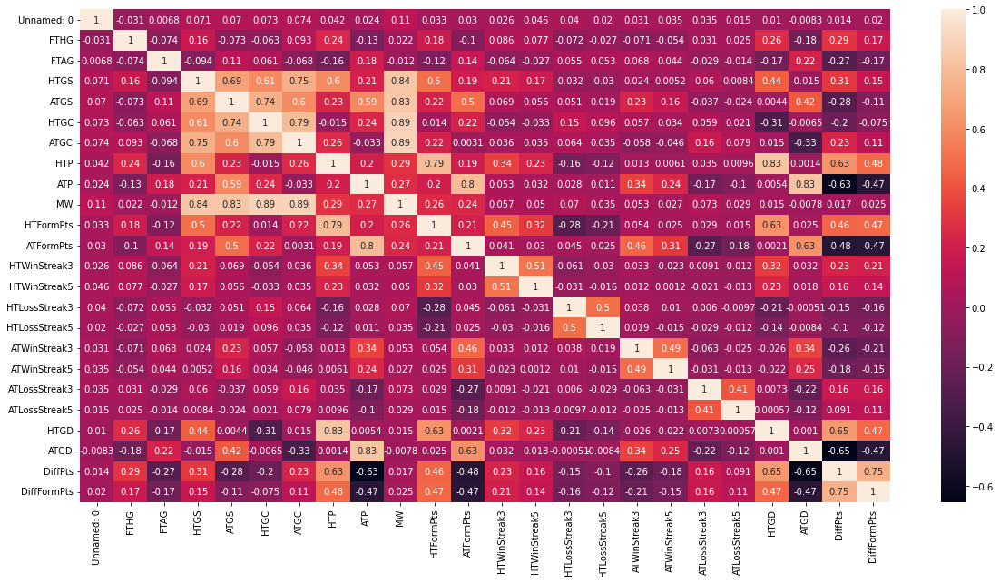

In [26]:
plt.figure(figsize=(20,10)) 
sns.heatmap(dataset.corr(), annot= True)

In [26]:
# Remove few column
dataset2 = dataset.copy().drop(columns =['Date', 'HomeTeam', 'AwayTeam', 'FTHG', 'FTAG',
       'HTGS', 'ATGS', 'HTGC', 'ATGC',
       'HM4', 'HM5','AM4', 'AM5', 'MW', 'HTFormPtsStr',
       'ATFormPtsStr', 'HTFormPts', 'ATFormPts', 'HTWinStreak3',
       'HTWinStreak5', 'HTLossStreak3', 'HTLossStreak5', 'ATWinStreak3',
       'ATWinStreak5', 'ATLossStreak3', 'ATLossStreak5',
       'DiffPts'] )

NameError: name 'dataset' is not defined

In [28]:
test2 = test.copy().drop(columns =['Date', 'HomeTeam', 'AwayTeam', 'FTHG', 'FTAG',
       'HTGS', 'ATGS', 'HTGC', 'ATGC',
       'HM4', 'HM5','AM4', 'AM5', 'MW', 'HTFormPtsStr',
       'ATFormPtsStr', 'HTFormPts', 'ATFormPts', 'HTWinStreak3',
       'HTWinStreak5', 'HTLossStreak3', 'HTLossStreak5', 'ATWinStreak3',
       'ATWinStreak5', 'ATLossStreak3', 'ATLossStreak5',
       'DiffPts'] )

In [29]:
test2

,Unnamed: 0,FTR,HTP,ATP,HM1,HM2,HM3,AM1,AM2,AM3,HTGD,ATGD,DiffFormPts
0,3040,H,0.000000,0.000000,M,M,M,M,M,M,0.000000,0.000000,0.000000
1,3041,NH,0.000000,0.000000,M,M,M,M,M,M,0.000000,0.000000,0.000000
2,3042,NH,0.000000,0.000000,M,M,M,M,M,M,0.000000,0.000000,0.000000
3,3043,NH,0.000000,0.000000,M,M,M,M,M,M,0.000000,0.000000,0.000000
4,3044,H,0.000000,0.000000,M,M,M,M,M,M,0.000000,0.000000,0.000000
5,3045,NH,0.000000,0.000000,M,M,M,M,M,M,0.000000,0.000000,0.000000
6,3046,NH,0.000000,0.000000,M,M,M,M,M,M,0.000000,0.000000,0.000000
7,3047,H,0.000000,0.000000,M,M,M,M,M,M,0.000000,0.000000,0.000000
8,3048,H,0.000000,0.000000,M,M,M,M,M,M,0.000000,0.000000,0.000000
9,3049,NH,0.000000,0.000000,M,M,M,M,M,M,0.000000,0.000000,0.000000


In [30]:
dataset2.keys()

Index(['Unnamed: 0', 'FTR', 'HTP', 'ATP', 'HM1', 'HM2', 'HM3', 'AM1', 'AM2',
       'AM3', 'HTGD', 'ATGD', 'DiffFormPts'],
      dtype='object')

In [31]:
dataset2.head()

,Unnamed: 0,FTR,HTP,ATP,HM1,HM2,HM3,AM1,AM2,AM3,HTGD,ATGD,DiffFormPts
0,0,NH,0.0,0.0,M,M,M,M,M,M,0.0,0.0,0.0
1,1,NH,0.0,0.0,M,M,M,M,M,M,0.0,0.0,0.0
2,2,NH,0.0,0.0,M,M,M,M,M,M,0.0,0.0,0.0
3,3,H,0.0,0.0,M,M,M,M,M,M,0.0,0.0,0.0
4,4,NH,0.0,0.0,M,M,M,M,M,M,0.0,0.0,0.0


In [32]:
#what is the win rate for the home team?

# Total number of matches.
n_matches = dataset2.shape[0]

# Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
n_features = dataset2.shape[1] - 1

# Calculate matches won by home team.
n_homewins = len(dataset2[dataset2.FTR == 'H'])

# Calculate win rate for home team.
win_rate = (float(n_homewins) / (n_matches)) * 100

# Print the results
print("Total number of matches: {}".format(n_matches))
print ("Number of features: {}".format(n_features))
print( "Number of matches won by home team: {}".format(n_homewins))
print ("Win rate of home team: {:.2f}%".format(win_rate))

Total number of matches: 3420
Number of features: 12
Number of matches won by home team: 1577
Win rate of home team: 46.11%


In [33]:
#what is the win rate for the home team?

# Total number of matches.
n_matches = dataset2.shape[0]

# Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
n_features = dataset2.shape[1] - 1

# Calculate matches won by home team.
n_awaywins = len(dataset2[dataset2.FTR == 'NH'])

# Calculate win rate for home team.
win_rate = (float(n_awaywins) / (n_matches)) * 100

# Print the results
print("Total number of matches: {}".format(n_matches))
print ("Number of features: {}".format(n_features))
print( "Number of matches won by away team: {}".format(n_awaywins))
print ("Win rate of away team: {:.2f}%".format(win_rate))

Total number of matches: 3420
Number of features: 12
Number of matches won by away team: 1843
Win rate of away team: 53.89%


array([[<AxesSubplot:xlabel='HTGD', ylabel='HTGD'>,
        <AxesSubplot:xlabel='ATGD', ylabel='HTGD'>,
        <AxesSubplot:xlabel='HTP', ylabel='HTGD'>,
        <AxesSubplot:xlabel='ATP', ylabel='HTGD'>,
        <AxesSubplot:xlabel='DiffFormPts', ylabel='HTGD'>],
       [<AxesSubplot:xlabel='HTGD', ylabel='ATGD'>,
        <AxesSubplot:xlabel='ATGD', ylabel='ATGD'>,
        <AxesSubplot:xlabel='HTP', ylabel='ATGD'>,
        <AxesSubplot:xlabel='ATP', ylabel='ATGD'>,
        <AxesSubplot:xlabel='DiffFormPts', ylabel='ATGD'>],
       [<AxesSubplot:xlabel='HTGD', ylabel='HTP'>,
        <AxesSubplot:xlabel='ATGD', ylabel='HTP'>,
        <AxesSubplot:xlabel='HTP', ylabel='HTP'>,
        <AxesSubplot:xlabel='ATP', ylabel='HTP'>,
        <AxesSubplot:xlabel='DiffFormPts', ylabel='HTP'>],
       [<AxesSubplot:xlabel='HTGD', ylabel='ATP'>,
        <AxesSubplot:xlabel='ATGD', ylabel='ATP'>,
        <AxesSubplot:xlabel='HTP', ylabel='ATP'>,
        <AxesSubplot:xlabel='ATP', ylabel='ATP'>,
     

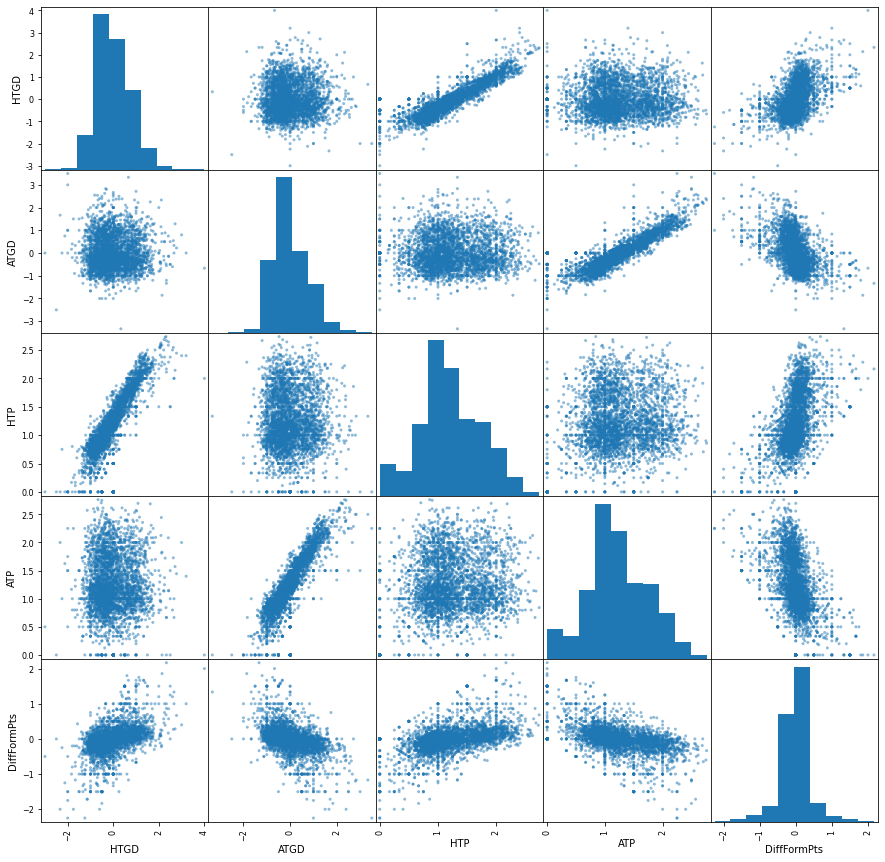

In [34]:
# Visualising distribution of data
from pandas.plotting import scatter_matrix
scatter_matrix(dataset2[['HTGD','ATGD','HTP','ATP','DiffFormPts']], figsize=(15,15))

In [35]:
# Separate into feature set and target variable
#FTR = Full Time Result (H=Home Win, D=Draw, A=Away Win)
X_all = dataset2.drop(['FTR'],1)
y_all = dataset2['FTR']

# Standardising the data.
from sklearn.preprocessing import scale

#Center to the mean and component wise scale to unit variance.
cols = [['HTGD','ATGD','HTP','ATP']]
for col in cols:
    X_all[col] = scale(X_all[col])
    

In [36]:
#last 3 wins for both sides
X_all.HM1 = X_all.HM1.astype('str')
X_all.HM2 = X_all.HM2.astype('str')
X_all.HM3 = X_all.HM3.astype('str')
X_all.AM1 = X_all.AM1.astype('str')
X_all.AM2 = X_all.AM2.astype('str')
X_all.AM3 = X_all.AM3.astype('str')

#we want continous vars that are integers for our input data, so lets remove any categorical vars
def preprocess_features(X):
    ''' Preprocesses the football data and converts catagorical variables into dummy variables. '''
    
    # Initialize new output DataFrame
    output = pd.DataFrame(index = X.index)

    # Investigate each feature column for the data
    for col, col_data in X.iteritems():

        # If data type is categorical, convert to dummy variables
        if col_data.dtype == object:
            col_data = pd.get_dummies(col_data, prefix = col)
                    
        # Collect the revised columns
        output = output.join(col_data)
    
    return output

X_all = preprocess_features(X_all)
print ("Processed feature columns ({} total features):\n{}".format(len(X_all.columns), list(X_all.columns)))

Processed feature columns (30 total features):
['Unnamed: 0', 'HTP', 'ATP', 'HM1_D', 'HM1_L', 'HM1_M', 'HM1_W', 'HM2_D', 'HM2_L', 'HM2_M', 'HM2_W', 'HM3_D', 'HM3_L', 'HM3_M', 'HM3_W', 'AM1_D', 'AM1_L', 'AM1_M', 'AM1_W', 'AM2_D', 'AM2_L', 'AM2_M', 'AM2_W', 'AM3_D', 'AM3_L', 'AM3_M', 'AM3_W', 'HTGD', 'ATGD', 'DiffFormPts']


In [37]:
from sklearn.model_selection import train_test_split

# Shuffle and split the dataset into training and testing set.
X_train, X_test, y_train, y_test = train_test_split(X_all, y_all, 
                                                    test_size = 0.2,
                                                    random_state = 2,
                                                    stratify = y_all)

In [38]:
from sklearn.linear_model import LogisticRegression
classifier = LogisticRegression(random_state = 0)
classifier.fit(X_train, y_train)
Y_pred = classifier.predict(X_test)

In [39]:
from sklearn.metrics import confusion_matrix, classification_report
cm = confusion_matrix(y_test, Y_pred)

In [40]:
print(classification_report(y_test, Y_pred))

              precision    recall  f1-score   support

           H       0.63      0.53      0.57       315
          NH       0.64      0.73      0.69       369

    accuracy                           0.64       684
   macro avg       0.64      0.63      0.63       684
weighted avg       0.64      0.64      0.63       684



In [41]:
from sklearn.naive_bayes import GaussianNB
classifier = GaussianNB()
classifier.fit(X_train, y_train)
Y_pred = classifier.predict(X_test)

In [42]:
from sklearn.metrics import confusion_matrix, classification_report
cm = confusion_matrix(y_test, Y_pred)

In [43]:
print(classification_report(y_test, Y_pred))

              precision    recall  f1-score   support

           H       0.59      0.73      0.65       315
          NH       0.71      0.56      0.63       369

    accuracy                           0.64       684
   macro avg       0.65      0.65      0.64       684
weighted avg       0.65      0.64      0.64       684



In [44]:
from sklearn.ensemble import RandomForestClassifier
#classifier = RandomForestClassifier(n_estimators = 10, criterion = 'entropy', random_state = 0)
classifier = RandomForestClassifier(criterion='gini', 
                             n_estimators=700,
                             min_samples_split=10,
                             min_samples_leaf=1,
                             max_features='auto',
                             oob_score=True,
                             random_state=1,
                             n_jobs=-1)
classifier.fit(X_train, y_train)

D:\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py:427: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


RandomForestClassifier(max_features='auto', min_samples_split=10,
                       n_estimators=700, n_jobs=-1, oob_score=True,
                       random_state=1)

In [45]:
Y_pred = classifier.predict(X_test)

In [46]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, Y_pred)

In [47]:
print(classification_report(y_test, Y_pred))

              precision    recall  f1-score   support

           H       0.62      0.49      0.55       315
          NH       0.63      0.75      0.69       369

    accuracy                           0.63       684
   macro avg       0.63      0.62      0.62       684
weighted avg       0.63      0.63      0.62       684



In [48]:
from xgboost import XGBClassifier
classifier = XGBClassifier(seed=25)
classifier.fit(X_train, y_train)

D:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[14:47:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=12, num_parallel_tree=1, random_state=25,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=25,
              subsample=1, tree_method='exact', validate_parameters=1,
              verbosity=None)

In [49]:
Y_pred = classifier.predict(X_test)

In [50]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, Y_pred)

In [51]:
print(classification_report(y_test, Y_pred))

              precision    recall  f1-score   support

           H       0.60      0.53      0.56       315
          NH       0.63      0.69      0.66       369

    accuracy                           0.62       684
   macro avg       0.62      0.61      0.61       684
weighted avg       0.62      0.62      0.62       684



In [52]:
# TODO: Import 'GridSearchCV' and 'make_scorer'
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, f1_score
import xgboost as xgb

# TODO: Create the parameters list you wish to tune
parameters = { 'learning_rate' : [0.1],
               'n_estimators' : [40],
               'max_depth': [3],
               'min_child_weight': [3],
               'gamma':[0.4],
               'subsample' : [0.8],
               'colsample_bytree' : [0.8],
               'scale_pos_weight' : [1],
               'reg_alpha':[1e-5]
             }  

def predict_labels(clf, features, target):
    ''' Makes predictions using a fit classifier based on F1 score. '''

    y_pred = clf.predict(features)
    
    return f1_score(target, y_pred, pos_label='H'), sum(target == y_pred) / float(len(y_pred))


# TODO: Initialize the classifier
clf = xgb.XGBClassifier(seed=2)

# TODO: Make an f1 scoring function using 'make_scorer' 
f1_scorer = make_scorer(f1_score,pos_label='H')

# TODO: Perform grid search on the classifier using the f1_scorer as the scoring method
grid_obj = GridSearchCV(clf,
                        scoring=f1_scorer,
                        param_grid=parameters,
                        cv=5)

# TODO: Fit the grid search object to the training data and find the optimal parameters
grid_obj = grid_obj.fit(X_train,y_train)

# Get the estimator
clf = grid_obj.best_estimator_
print(clf)

# Report the final F1 score for training and testing after parameter tuning
f1, acc = predict_labels(clf, X_train, y_train)
print( "F1 score and accuracy score for training set: {:.4f} , {:.4f}.".format(f1 , acc))
    
f1, acc = predict_labels(clf, X_test, y_test)
print("F1 score and accuracy score for test set: {:.4f} , {:.4f}.".format(f1 , acc))

D:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
D:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
D:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is depre

[14:48:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

D:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Creating a GUI

In [49]:
pip install tkinter

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement tkinter (from versions: none)
ERROR: No matching distribution found for tkinter


In [53]:
import tkinter as Tk

In [23]:
data1 = df2
df1 = pd.DataFrame(data1)
df1

,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTGS,ATGS,HTGC,ATGC,HTP,ATP,HM1,HM2,HM3,HM4,HM5,AM1,AM2,AM3,AM4,AM5,MW,HTFormPtsStr,ATFormPtsStr,HTFormPts,ATFormPts,HTWinStreak3,HTWinStreak5,HTLossStreak3,HTLossStreak5,ATWinStreak3,ATWinStreak5,ATLossStreak3,ATLossStreak5,HTGD,ATGD,DiffPts,DiffFormPts
0,15/08/09,Aston Villa,Wigan,0,2,A,0,0,0,0,0.000000,0.000000,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
1,15/08/09,Blackburn,Man City,0,2,A,0,0,0,0,0.000000,0.000000,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
2,15/08/09,Bolton,Sunderland,0,1,A,0,0,0,0,0.000000,0.000000,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
3,15/08/09,Chelsea,Hull,2,1,H,0,0,0,0,0.000000,0.000000,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
4,15/08/09,Everton,Arsenal,1,6,A,0,0,0,0,0.000000,0.000000,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
5,15/08/09,Portsmouth,Fulham,0,1,A,0,0,0,0,0.000000,0.000000,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
6,15/08/09,Stoke,Burnley,2,0,H,0,0,0,0,0.000000,0.000000,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
7,15/08/09,Wolves,West Ham,0,2,A,0,0,0,0,0.000000,0.000000,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
8,16/08/09,Man United,Birmingham,1,0,H,0,0,0,0,0.000000,0.000000,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000
9,16/08/09,Tottenham,Liverpool,2,1,H,0,0,0,0,0.000000,0.000000,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000


In [24]:
# Remove few column
dataset2 = df1.copy().drop(columns =['Date','FTHG', 'FTAG', 'HTP', 'ATP',
       'HTGS', 'ATGS', 'HTGC', 'ATGC','DiffPts','HTGD','ATGD'] )


In [25]:
pd.set_option('display.max_columns', None)
dataset2

,HomeTeam,AwayTeam,FTR,HM1,HM2,HM3,HM4,HM5,AM1,AM2,AM3,AM4,AM5,MW,HTFormPtsStr,ATFormPtsStr,HTFormPts,ATFormPts,HTWinStreak3,HTWinStreak5,HTLossStreak3,HTLossStreak5,ATWinStreak3,ATWinStreak5,ATLossStreak3,ATLossStreak5,DiffFormPts
0,Aston Villa,Wigan,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000
1,Blackburn,Man City,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000
2,Bolton,Sunderland,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000
3,Chelsea,Hull,H,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000
4,Everton,Arsenal,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000
5,Portsmouth,Fulham,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000
6,Stoke,Burnley,H,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000
7,Wolves,West Ham,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000
8,Man United,Birmingham,H,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000
9,Tottenham,Liverpool,H,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000


In [32]:
# Gets the form points.
def get_resh(string):
    if string == 'A':
        return 0    
    elif string == 'D':
        return 0.5
    else:
        return 1

def get_resa(string):
    if string == 'H':
        return 0
    elif string == 'D':
        return 0.5
    else:
        return 1
    
dataset2['ResH'] = dataset2['FTR'].apply(get_resh)
dataset2['ResA'] = dataset2['FTR'].apply(get_resa)

dataset2

,HomeTeam,AwayTeam,FTR,HM1,HM2,HM3,HM4,HM5,AM1,AM2,AM3,AM4,AM5,MW,HTFormPtsStr,ATFormPtsStr,HTFormPts,ATFormPts,HTWinStreak3,HTWinStreak5,HTLossStreak3,HTLossStreak5,ATWinStreak3,ATWinStreak5,ATLossStreak3,ATLossStreak5,DiffFormPts,ResH,ResA
0,Aston Villa,Wigan,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.0,1.0
1,Blackburn,Man City,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.0,1.0
2,Bolton,Sunderland,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.0,1.0
3,Chelsea,Hull,H,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,1.0,0.0
4,Everton,Arsenal,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.0,1.0
5,Portsmouth,Fulham,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.0,1.0
6,Stoke,Burnley,H,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,1.0,0.0
7,Wolves,West Ham,A,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,0.0,1.0
8,Man United,Birmingham,H,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,1.0,0.0
9,Tottenham,Liverpool,H,M,M,M,M,M,M,M,M,M,M,1.0,MMMMM,MMMMM,0,0,0,0,0,0,0,0,0,0,0.000000,1.0,0.0


In [33]:
# Remove few column
dataset3 = dataset2.copy().drop(columns =['FTR','HM1','HM2', 'HM3', 'HM4', 'HM5','AM1','AM2', 'AM3', 'AM4', 'AM5',
       'HTFormPts', 'ATFormPts','HTFormPtsStr', 'ATFormPtsStr', 'HTWinStreak3','DiffFormPts','HTWinStreak3','HTLossStreak3','ATLossStreak5','ATWinStreak3','ATLossStreak3','ATLossStreak5','ATWinStreak5','HTWinStreak5','HTLossStreak5'] )

In [34]:
pd.set_option('display.max_rows', 4000)
dataset3

,HomeTeam,AwayTeam,MW,ResH,ResA
0,Aston Villa,Wigan,1.0,0.0,1.0
1,Blackburn,Man City,1.0,0.0,1.0
2,Bolton,Sunderland,1.0,0.0,1.0
3,Chelsea,Hull,1.0,1.0,0.0
4,Everton,Arsenal,1.0,0.0,1.0
5,Portsmouth,Fulham,1.0,0.0,1.0
6,Stoke,Burnley,1.0,1.0,0.0
7,Wolves,West Ham,1.0,0.0,1.0
8,Man United,Birmingham,1.0,1.0,0.0
9,Tottenham,Liverpool,1.0,1.0,0.0


In [35]:
import math

num_seasons = math.ceil(len(dataset3) / 38)

season_labels = []
for i in range(1, num_seasons+1):
    season_label =  i
    season_labels.extend([season_label] * 380)

# Add the season labels as a new column in the dataframe
dataset3["Season"] = season_labels[:len(dataset3)]

In [36]:
pd.set_option('display.max_rows', 4000)
cols = ['Season', 'HomeTeam', 'AwayTeam', 'MW', 'ResH', 'ResA']
dataset3 = dataset3[cols]
dataset3.sort_values("Season")
dataset3

,Season,HomeTeam,AwayTeam,MW,ResH,ResA
0,1,Aston Villa,Wigan,1.0,0.0,1.0
1,1,Blackburn,Man City,1.0,0.0,1.0
2,1,Bolton,Sunderland,1.0,0.0,1.0
3,1,Chelsea,Hull,1.0,1.0,0.0
4,1,Everton,Arsenal,1.0,0.0,1.0
5,1,Portsmouth,Fulham,1.0,0.0,1.0
6,1,Stoke,Burnley,1.0,1.0,0.0
7,1,Wolves,West Ham,1.0,0.0,1.0
8,1,Man United,Birmingham,1.0,1.0,0.0
9,1,Tottenham,Liverpool,1.0,1.0,0.0


In [37]:
dataset3["MW"] = dataset3['MW'].astype(int)
dataset3

,Season,HomeTeam,AwayTeam,MW,ResH,ResA
0,1,Aston Villa,Wigan,1,0.0,1.0
1,1,Blackburn,Man City,1,0.0,1.0
2,1,Bolton,Sunderland,1,0.0,1.0
3,1,Chelsea,Hull,1,1.0,0.0
4,1,Everton,Arsenal,1,0.0,1.0
5,1,Portsmouth,Fulham,1,0.0,1.0
6,1,Stoke,Burnley,1,1.0,0.0
7,1,Wolves,West Ham,1,0.0,1.0
8,1,Man United,Birmingham,1,1.0,0.0
9,1,Tottenham,Liverpool,1,1.0,0.0


In [38]:
#what is the win rate for the home team?

# Total number of matches.
n_matches = dataset3.shape[0]

# Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
n_features = dataset3.shape[1] - 1

# Calculate matches won by home team.
n_homewins = len(dataset3[dataset3.ResH == 1.0])

# Calculate win rate for home team.
win_rate = (float(n_homewins) / (n_matches)) * 100

# Print the results
print("Total number of matches: {}".format(n_matches))
print ("Number of features: {}".format(n_features))
print( "Number of matches won by home team: {}".format(n_homewins))
print ("Win rate of home team: {:.2f}%".format(win_rate))

Total number of matches: 3420
Number of features: 5
Number of matches won by home team: 1577
Win rate of home team: 46.11%


In [39]:
#what is the draw rate for the home team?

# Total number of matches.
n_matches = dataset3.shape[0]

# Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
n_features = dataset3.shape[1] - 1

# Calculate matches won by home team.
n_draw = len(dataset3[dataset3.ResH == 0.5])

# Calculate win rate for home team.
draw_rate = (float(n_draw) / (n_matches)) * 100

# Print the results
print("Total number of matches: {}".format(n_matches))
print ("Number of features: {}".format(n_features))
print( "Number of matches drawn: {}".format(n_draw))
print ("Draw rate: {:.2f}%".format(draw_rate))

Total number of matches: 3420
Number of features: 5
Number of matches drawn: 869
Draw rate: 25.41%


In [40]:
#what is the loss rate for the home team?

# Total number of matches.
n_matches = dataset3.shape[0]

# Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
n_features = dataset3.shape[1] - 1

# Calculate matches won by home team.
n_loss = len(dataset3[dataset3.ResH == 0])

# Calculate win rate for home team.
loss_rate = (float(n_loss) / (n_matches)) * 100

# Print the results
print("Total number of matches: {}".format(n_matches))
print ("Number of features: {}".format(n_features))
print( "Number of matches lost by home team: {}".format(n_loss))
print ("loss rate of home team: {:.2f}%".format(loss_rate))

Total number of matches: 3420
Number of features: 5
Number of matches lost by home team: 974
loss rate of home team: 28.48%


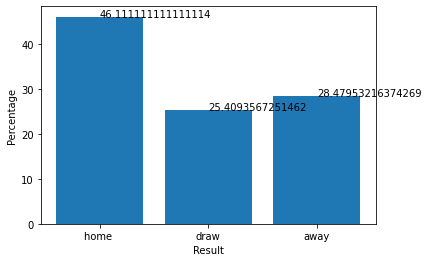

In [61]:
rate = [win_rate, draw_rate, loss_rate]
name = ["home ", "draw", "away"]

def addlabels(x,y):
    for i in range(len(x)):
        plt.text(i,y[i],y[i])

plt.bar(name, rate)
addlabels(name, rate)
plt.xlabel("Result")
plt.ylabel("Percentage")
plt.show()

In [67]:
pip install plotly_express==0.4.0

Note: you may need to restart the kernel to use updated packages.


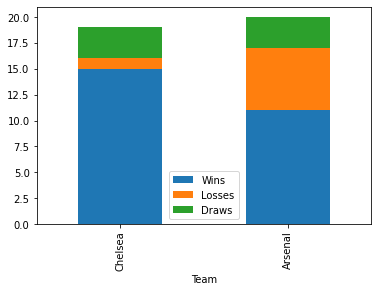

In [69]:
def predict_result(s,h,a,m):
    season = s
    home_team = h
    away_team = a
    mw = m
    home_matches = dataset3[(dataset3["Season"] == season) & (dataset3["HomeTeam"] == home_team)]
    away_matches = dataset3[(dataset3["Season"] == season) & (dataset3["AwayTeam"] == away_team)]
    home_wins = len(home_matches[home_matches["ResH"] == 1])
    home_losses = len(home_matches[home_matches["ResH"] == 0])
    away_wins = len(away_matches[away_matches["ResA"] == 1])
    away_losses = len(away_matches[away_matches["ResA"] == 0])
    home_draw = len(home_matches[home_matches["ResH"] == 0.5])
    away_draw = len(home_matches[home_matches["ResA"] == 0.5])
    total_matches = home_wins + home_losses + away_wins + away_losses + home_draw + away_draw
   
    home_win_pct = home_wins / total_matches
    away_win_pct = away_wins / total_matches
    home_draw_pct = home_draw / total_matches
    away_draw_pct = away_draw / total_matches
    win_loss_draw_df = pd.DataFrame({
       "Team": [home_team, away_team],
        "Wins": [home_wins, away_wins],
        "Losses": [home_losses, away_losses],
        "Draws": [home_draw, away_draw]
    })
    win_loss_draw_df.set_index("Team", inplace=True)
    win_loss_draw_df.plot(kind="bar", stacked=True)
    plt.show()
    
predict_result(5,"Chelsea", "Arsenal", 5)

In [165]:
def predict_result(s,h,a,m):
    season = s
    home_team = h
    away_team = a
    mw = m
    datah = dataset3.loc[(dataset3['Season'] == season) & (dataset3['HomeTeam'] == home_team) & (dataset3['MW'].isin(range(1,mw+1)))]
    dataa = dataset3.loc[(dataset3['Season'] == season) & (dataset3['AwayTeam'] == away_team) & (dataset3['MW'].isin(range(1,mw+1)))]
    
    #what is the loss rate for the home team?

    # Total number of matches.
    n_matches = datah.shape[0]
    if(datah.empty == True):
        print("The team did not play in the following season")
    else:
        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = datah.shape[1] - 1

        # Calculate matches lost by home team.
        n_loss = len(datah[datah.ResH == 0])

        # Calculate lost rate for home team.
        lrh = (float(n_loss) / (n_matches)) * 100

        # Total number of matches.
        n_matches = dataa.shape[0]

        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = dataa.shape[1] - 1

        # Calculate matches lost by away team.
        n_loss = len(dataa[dataa.ResA == 0])

        # Calculate away rate for away team.
        lra = (float(n_loss) / (n_matches)) * 100


        # Total number of matches.
        n_matches = datah.shape[0]

        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = datah.shape[1] - 1

        # Calculate matches won by home team.
        n_win = len(datah[datah.ResH == 1])

        # Calculate win rate for home team.
        wrh = (float(n_win) / (n_matches)) * 100
        

        # Total number of matches.
        n_matches = dataa.shape[0]

        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = dataa.shape[1] - 1

        # Calculate matches won by home team.
        n_win = len(dataa[dataa.ResA == 1])

        # Calculate win rate for home team.
        wra = (float(n_loss) / (n_matches)) * 100

        #what is the draw rate for the home team?

        # Total number of matches.
        n_matches = datah.shape[0]

        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = datah.shape[1] - 1

        # Calculate matches won by home team.
        n_draw = len(datah[datah.ResH == 0.5])

        # Calculate win rate for home team.
        drh = (float(n_draw) / (n_matches)) * 100

        #what is the draw rate for the away team?

        # Total number of matches.
        n_matches = dataa.shape[0]

        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = dataa.shape[1] - 1

        # Calculate matches won by home team.
        n_draw = len(dataa[dataa.ResH == 0.5])

        # Calculate win rate for home team.
        dra = (float(n_draw) / (n_matches)) * 100

        #difference
        if(wrh>wra):
            win = wrh-wra
        else:
            win = wra-wrh
        if(drh>dra):
            draw = drh-dra
        else:
            draw = dra-drh
        if(lrh>lra):
            loss = lrh-lra
        else:
            loss = lra-lrh

        tot1 = win + loss + draw
        wpct1 = (win / tot1) * 100
        lpct1 = (loss / tot1) * 100
        dpct1 = (draw / tot1) * 100
        
        
    #REVERSED HOME AWAY LOGIC
    datah = dataset3.loc[(dataset3['Season'] == season) & (dataset3['HomeTeam'] == away_team) & (dataset3['MW'].isin(range(1,mw+1)))]
    dataa = dataset3.loc[(dataset3['Season'] == season) & (dataset3['AwayTeam'] == home_team) & (dataset3['MW'].isin(range(1,mw+1)))]
    
        #what is the loss rate for the home team?

    # Total number of matches.
    n_matches = datah.shape[0]
    if(datah.empty == True):
        print("The team did not play in the following season")
    else:
        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = datah.shape[1] - 1

        # Calculate matches lost by home team.
        n_loss = len(datah[datah.ResH == 0])

        # Calculate lost rate for home team.
        lrh = (float(n_loss) / (n_matches)) * 100

        # Total number of matches.
        n_matches = dataa.shape[0]

        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = dataa.shape[1] - 1

        # Calculate matches lost by away team.
        n_loss = len(dataa[dataa.ResA == 0])

        # Calculate away rate for away team.
        lra = (float(n_loss) / (n_matches)) * 100


        # Total number of matches.
        n_matches = datah.shape[0]

        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = datah.shape[1] - 1

        # Calculate matches won by home team.
        n_win = len(datah[datah.ResH == 1])

        # Calculate win rate for home team.
        wrh = (float(n_win) / (n_matches)) * 100
        

        # Total number of matches.
        n_matches = dataa.shape[0]

        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = dataa.shape[1] - 1

        # Calculate matches won by home team.
        n_win = len(dataa[dataa.ResA == 1])

        # Calculate win rate for home team.
        wra = (float(n_loss) / (n_matches)) * 100

        #what is the draw rate for the home team?

        # Total number of matches.
        n_matches = datah.shape[0]

        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = datah.shape[1] - 1

        # Calculate matches won by home team.
        n_draw = len(datah[datah.ResH == 0.5])

        # Calculate win rate for home team.
        drh = (float(n_draw) / (n_matches)) * 100

        #what is the draw rate for the away team?

        # Total number of matches.
        n_matches = dataa.shape[0]

        # Calculate number of features. -1 because we are saving one as the target variable (win/lose/draw)
        n_features = dataa.shape[1] - 1

        # Calculate matches won by home team.
        n_draw = len(dataa[dataa.ResH == 0.5])

        # Calculate win rate for home team.
        dra = (float(n_draw) / (n_matches)) * 100

        #difference
        if(wrh>wra):
            win = wrh-wra
        else:
            win = wra-wrh
        if(drh>dra):
            draw = drh-dra
        else:
            draw = dra-drh
        if(lrh>lra):
            loss = lrh-lra
        else:
            loss = lra-lrh

        tot2 = win + loss + draw
        wpct2 = (win / tot2) * 100
        lpct2 = (loss / tot2) * 100
        dpct2 = (draw / tot2) * 100
        
        wpct = (wpct1 + wpct2)/2
        dpct = (dpct1 + dpct2)/2
        lpct = (lpct1 + lpct2)/2
        
        

        # Create a list of colors for the chart
        colors = ["#39FF14", "#FF1818", "#808080"]

        # Calculate the values for the chart
        values = [wpct, lpct,dpct]

        # Create the chart
        fig, ax = plt.subplots()
        ax.axis("equal")
        _, _, autotexts = ax.pie(
            values,
            colors=colors,
            startangle=90,
            counterclock=False,
            wedgeprops={"linewidth": 1, "edgecolor": "white"},
            autopct=lambda pct: f"{pct:.1f}%"
        )

        # Add labels to the chart
        wpct = round(wpct,2)
        dpct = round(dpct,2)
        lpct = round(lpct,2)
        
        if (wpct > lpct):
            if (wpct > dpct):
                labels = f"{home_team} wins"
            else:
                labels = "Draw"
                
        elif (lpct > wpct):
            if (lpct > dpct):
                labels = f"{away_team} wins"
            else:
                labels = "Draw"
                
        elif (dpct > lpct):
            if (dpct > wpct):
                labels = f"{away_team} wins"
            else:
                labels = "Draw"
        
        elif (wpct - lpct == 0) | (lpct - wpct == 0):
            labels = "Draw"
        elif (wpct - dpct == 0) | (dpct - wpct == 0): 
            labels = f"{home_team} have Equal Chances of winning or drawing the match"
        elif (lpct - dpct == 0) | (dpct - lpct == 0):
            labels = f"{away_team} have Equal Chances of winning or drawing the match"
        else:
            print("Wrong Input")
        # Display the chart
        plt.show()
        
        print("Home Team Chances: ", wpct, "%")
        print("Draw Chances: ", dpct, "%")
        print("Away Team Chances: ", lpct, "%")
        return labels
    
predict_result(1,"H3ull", "St5oke", 12)

The team did not play in the following season
The team did not play in the following season


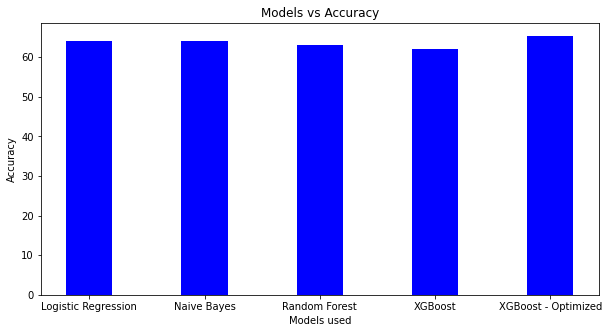

In [10]:
data = {'Logistic Regression':64, 'Naive Bayes':64, 'Random Forest':63, 'XGBoost':62, 'XGBoost - Optimized':65.35}
courses = list(data.keys())
values = list(data.values())
  
fig = plt.figure(figsize = (10, 5))
 
# creating the bar plot
plt.bar(courses, values, color ='blue',
        width = 0.4)
 
plt.xlabel("Models used")
plt.ylabel("Accuracy")
plt.title("Models vs Accuracy")
plt.show()